# Workshop 1 - Classical Image processing

Study of classical image processing methods. Meet with opencv or skimage. Digital image and what that mean; noises in image; histogram of image; methods for work with histogram; image filtering.

In [2]:
import numpy as np
import matplotlib.pyplot as plt

## Pillow Library

Python `Pillow` library is built on the top of` PIL` (Python Image Library). Pillow supports many image file formats including BMP, PNG, JPEG, and TIFF. <br>
The most important class in the Python Imaging Library is the `Image` class, defined in the module with the same name. <br>
The Pillow Image module provides the `open ()` and `show ()` function to read and display the image respectively. For displaying the image Pillow first converts the image to a .png format (on Windows OS) and stores it in a temporary buffer and then displays it. Therefore, due to the conversion of the image format to ".png" some properties of the original image file format might be lost (like animation). Therefore, it is advised to use this method only for test purposes. <br>
In addition, we will use `urllib` library to open images from the internet.

<blockquote>
<i>Note.</i> If you want to read "gif" or any other multi-frame format, use function `seek`, like it is shown below

```python
with Image.open("animation.gif") as im:
    im.seek(1) # skip to the second frame

    try:
        while 1:
            im.seek(im.tell()+1)
            # do something to im
    except EOFError:
        pass # end of sequence
```
<!-- https://www.geeksforgeeks.org/python-pillow-tutorial/ 
https://pillow.readthedocs.io/en/stable/handbook/tutorial.html -->

In [3]:
import urllib.request
from PIL import Image

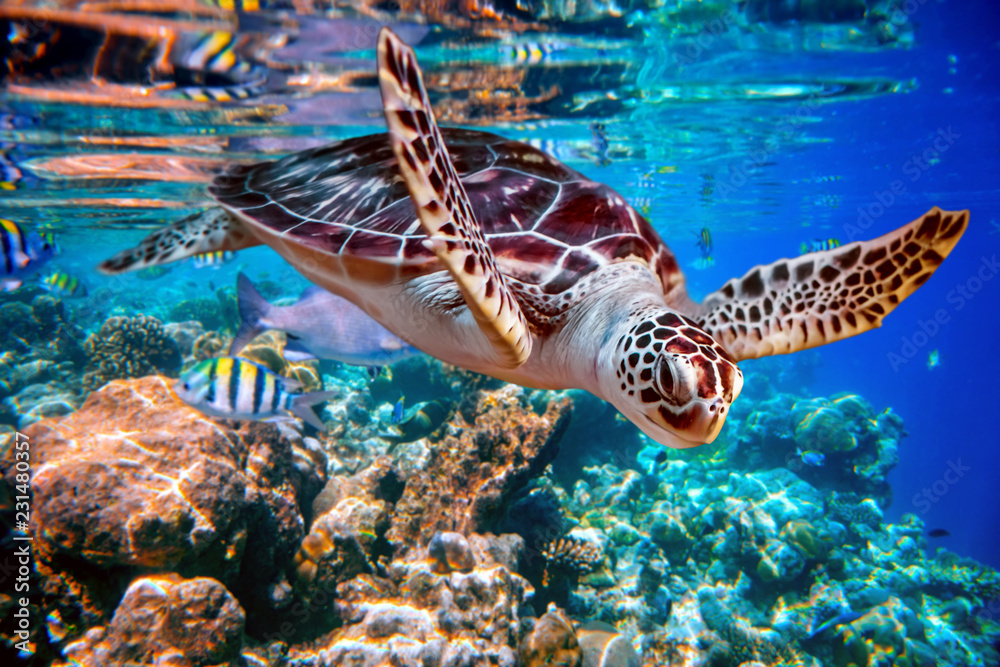

In [6]:
image_url = 'https://as2.ftcdn.net/v2/jpg/02/31/48/03/1000_F_231480357_TGpMz4r5HSFAlm43FkZ366FjFZuuoRA8.jpg'
  
urllib.request.urlretrieve(image_url,"image.png")
  
img = Image.open("image.png")
img
# img.show();

For an image from Pillow, you may obtain several characteristics. 
The `format` attribute identifies the source of an image. 
If the image was not read from a file, it is set to `None`. 
The `size` attribute is a 2-tuple containing width and height (in pixels). 
The `mode` attribute defines the number and names of the bands in the image, and also the pixel type and depth. 
Common modes are <ul>
    <li>'L' (luminance) for greyscale images, 
    <li> 'RGB' for true color images, 
    <li> 'CMYK' for pre-press images. </ul>

In [4]:
print(img.size, img.format, img.mode)
 

(1000, 667) JPEG RGB


PIL allows one to convert images using the method `convert`. A little trick for jupyter, if you do not want to open the picture in the new window, you may use the image name without methods, like it is shown below.

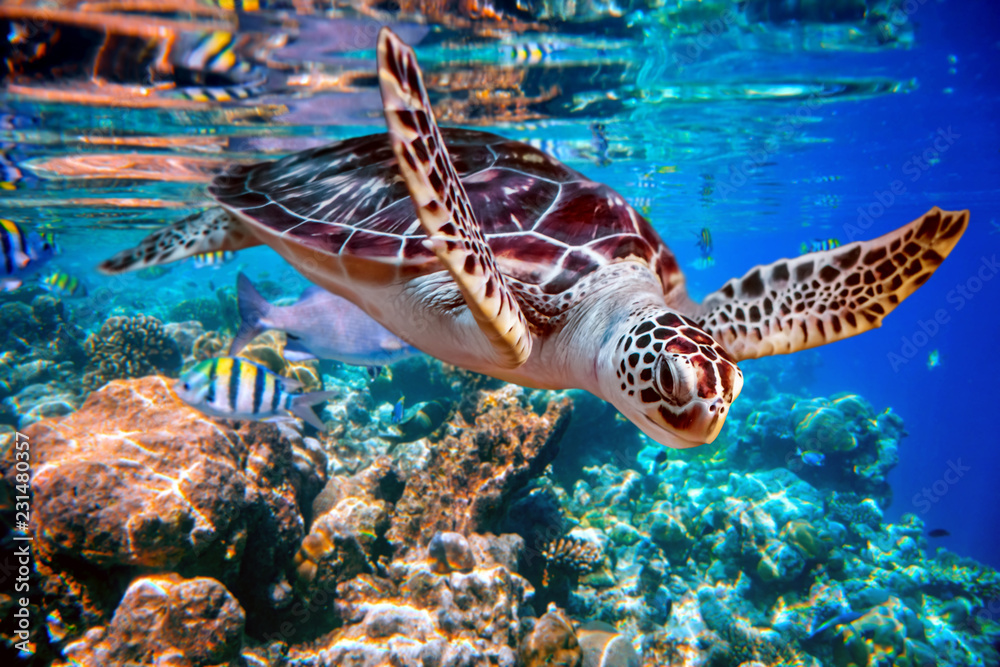

In [5]:
img

(1000, 667) None L


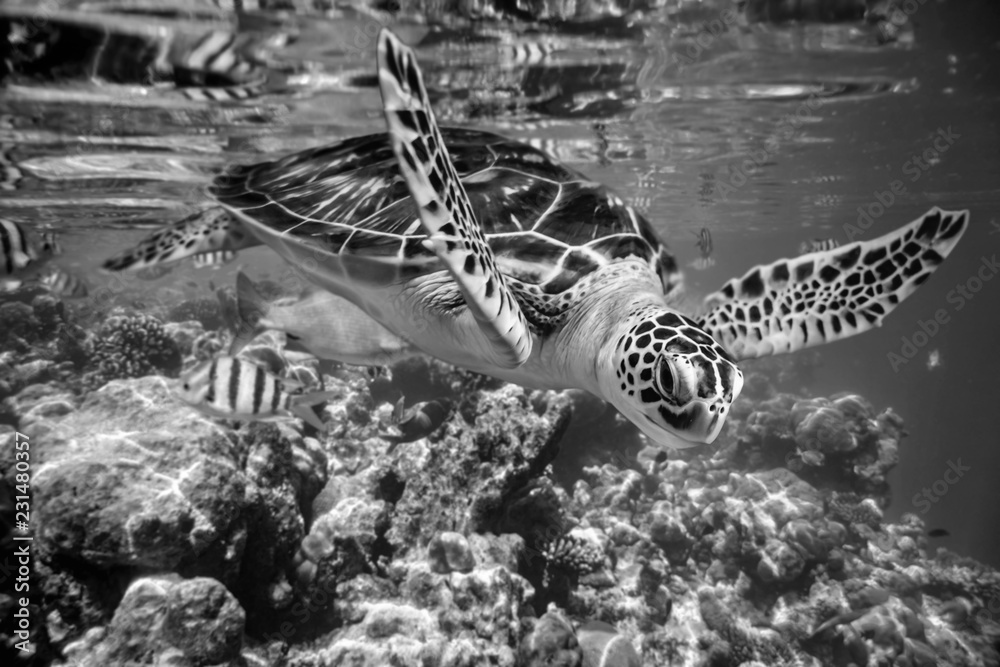

In [6]:
#"L", "RGB" and "CMYK."
img_gray = img.convert('L')

print(img_gray.size, img_gray.format, img_gray.mode)

img_gray


Actually, there are several transformations, you may do using PIL.
<br>For instance, lets squeeze the image size

(512, 342) JPEG RGB


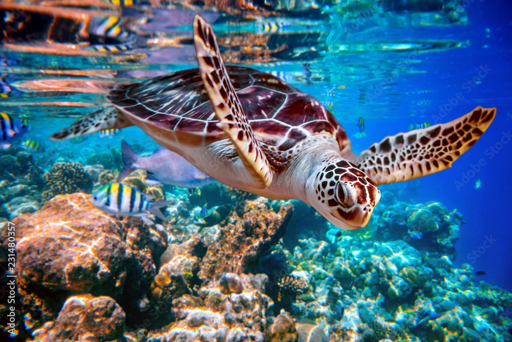

In [7]:
size = (512, 512)
img.thumbnail(size)
print(img.size, img.format, img.mode)
img


In addition, PIL allows one to make augmentation of images. <br>
Below you may find several examples of such operations<br>
>*Note* if you want to make some crop it is better to take the new name as output, or use `img_new = img.copy()` to create a new copy of the image.

Crop

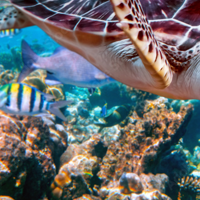

In [8]:
box = (100, 100, 300, 300)
region = img.crop(box)
region

Rotate

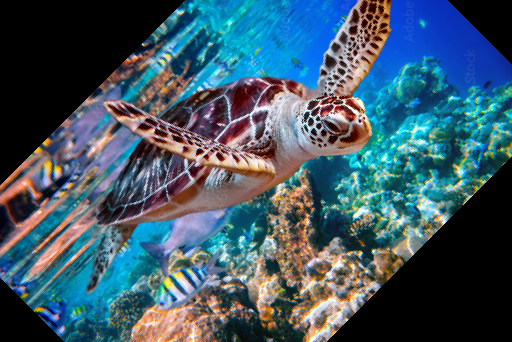

In [9]:
img_45 = img.rotate(angle=45)
img_45

Transpose

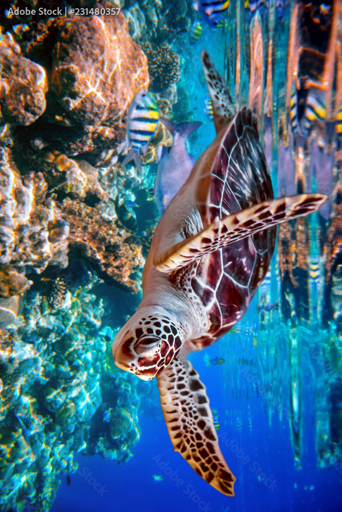

In [10]:
out = img.transpose(Image.ROTATE_270)
out

Flip

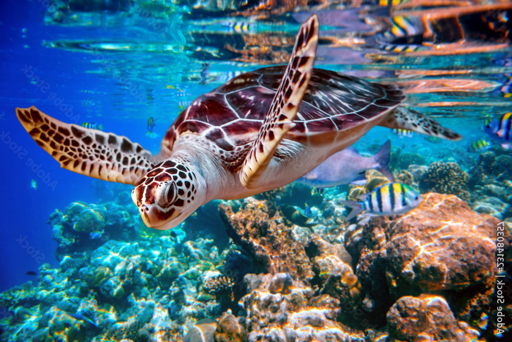

In [11]:
out = img.transpose(Image.FLIP_LEFT_RIGHT)
out


Channel mixing

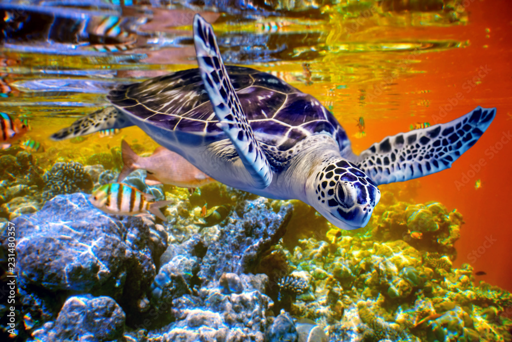

In [12]:
r, g, b = img.split()
img_brg = Image.merge("RGB", (b, g, r))
img_brg

Crop Mix

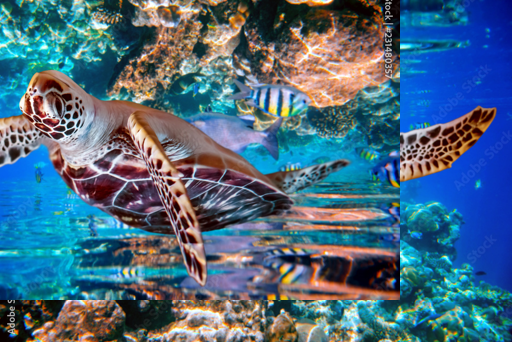

In [13]:
box = (0, 0, 400, 300)
region = img.crop(box)
region = region.transpose(Image.ROTATE_180)
imgm = img.copy()
imgm.paste(region, box)
imgm

To create new image use method `new`.

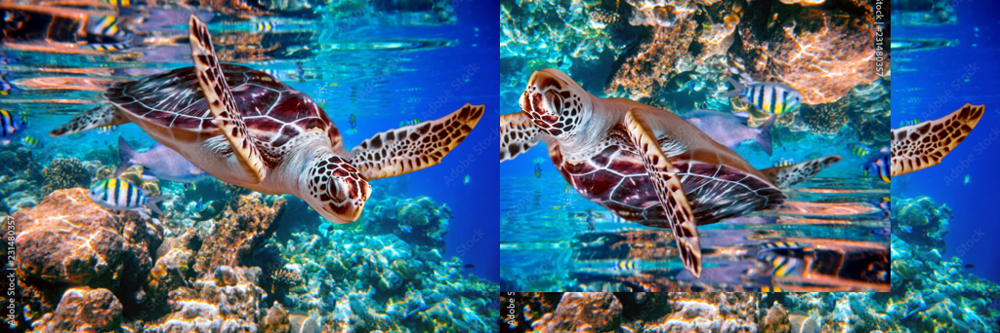

In [14]:
new_im = Image.new(mode='RGB', size = (2*img.size[0],1*img.size[1]), color=(250,250,250))
new_im.paste(img, (0,0))
new_im.paste(imgm, (img.size[0],0))
new_im  

You may also add some text or draw something using modules `ImageFont` and `ImageDraw`

In [8]:
from PIL import ImageFont
from PIL import ImageDraw

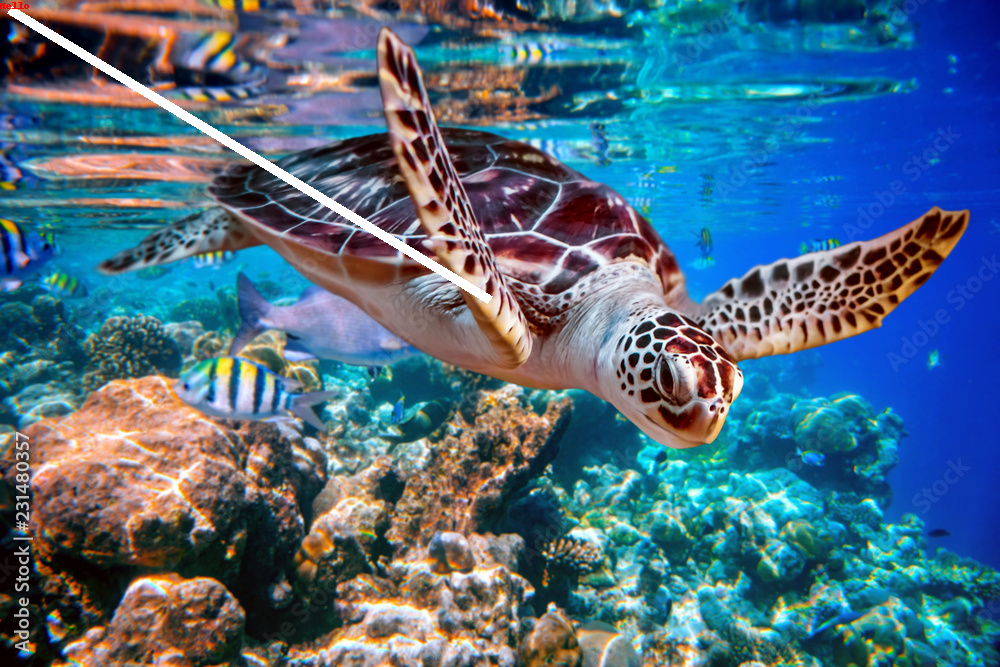

In [14]:
imgt = img.copy()
imgt.resize((512,512))
#line shape
shape = [(490, 300), (10, 10)]
 
img1 = ImageDraw.Draw(imgt) # create line image
img1.line(shape, width=10)
draw = ImageDraw.Draw(imgt)
draw.text((0, 0), "Hello", (255, 0, 0))
imgt

Also PIL contains several predefined image enhancement filters in the module `ImageFilter` and `ImageEnhance`.

In [15]:
from PIL import ImageFilter
from PIL import ImageEnhance

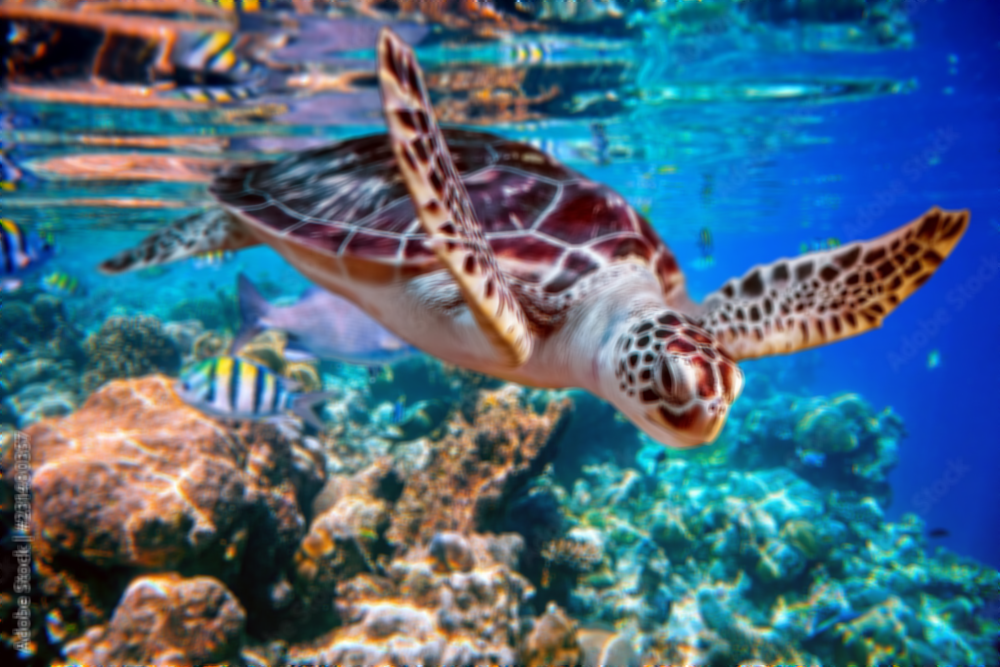

In [16]:
out = img.filter(ImageFilter.BLUR)
out

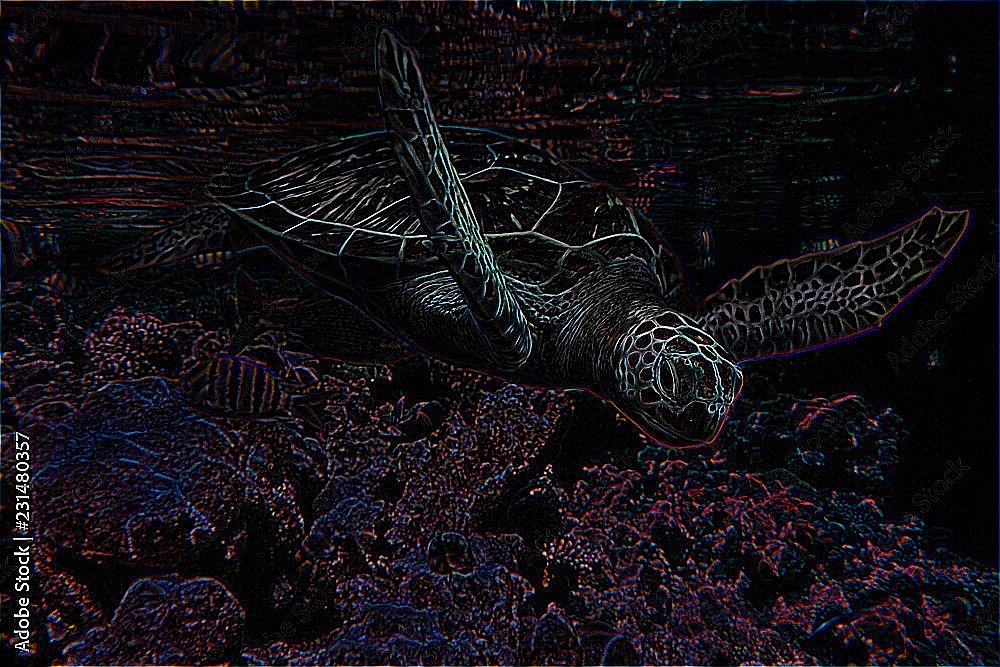

In [17]:
out = img.filter(ImageFilter.FIND_EDGES)
out

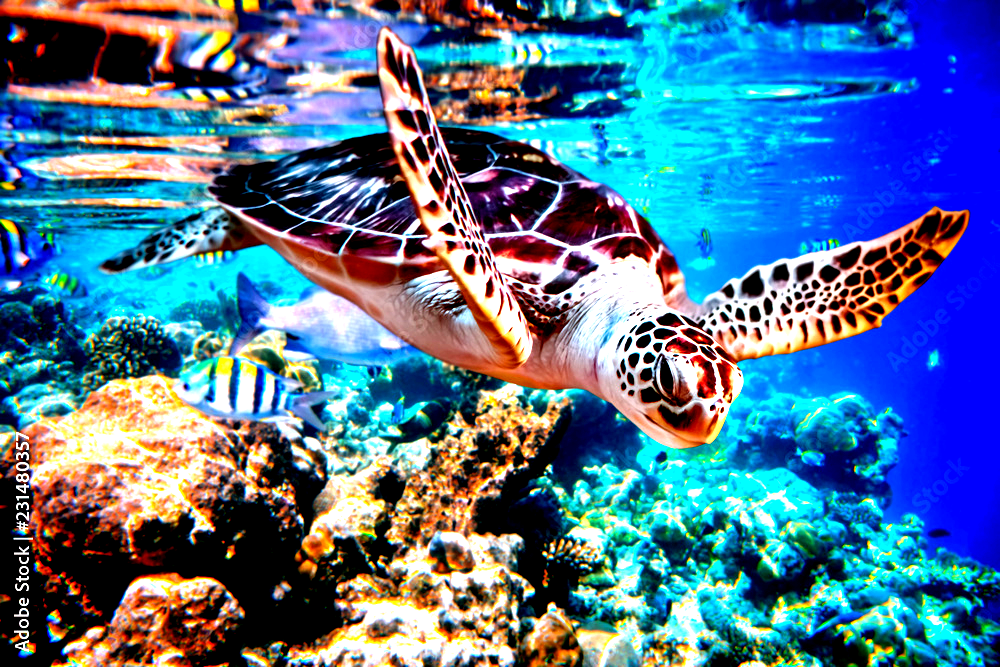

In [18]:
out = ImageEnhance.Contrast(img)
out = out.enhance(2.3)
out

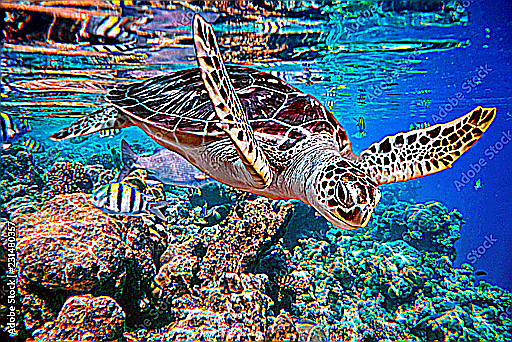

In [21]:
out = ImageEnhance.Sharpness(img)
out = out.enhance(23.0)
out

### Exercise 1 
1. Take  some low-quality images and try to enhance it quality with Pillow. For instance, use this one
https://thumbs.dreamstime.com/z/abstract-blur-cafe-coffee-shop-abstract-blur-cafe-coffee-shop-background-162453910.jpg.
2. Make some augmentation of the processed images (at least 5 variants).


## Numpy processing

To convert images from PIL to other formats you may use `np.array()`.<br>
>*Note* for backward convert use `Image.fromarray()`.<br>
> if you want to save image use `img.save(path_name)`.

(667, 1000, 3)


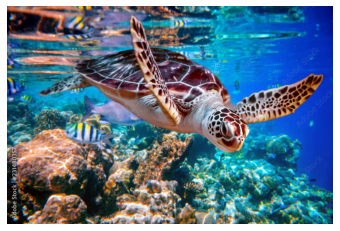

In [19]:
image = np.asarray(img)
plt.imshow(image); plt.axis('off');
print(image.shape)


Let's test how you may process images using numpy. 

But for the first we create auxilary function.

In [20]:
def axplot(image, ax=None, title='', standardize = False, **kwargs):
    ''' kwargs: figsize:(int,int); rows_cols:(int,int); finish:bool; ret_ax:bool'''
    image_ = image 
    
    if standardize:
        image_ = np.copy(image).astype(float)
        image_ = 255*(image_ - image_.min())/(image_.max()-image_.min())
        image_ = image_.astype(np.uint8)

    if ax is None:
        figsize   = (6,4) if kwargs.get('figsize')   is None else kwargs.get('figsize')
        rows_cols = (1,1) if kwargs.get('rows_cols') is None else kwargs.get('rows_cols')
        fig,ax  = plt.subplots(*rows_cols, figsize=figsize)
    
    ax_ = ax.ravel()[0] if type(ax) in [np.ndarray,list] else ax
    ax_.imshow(image_, cmap='gray'); ax_.axis('off'); ax_.set_title(title)
    
    if kwargs.get('finish'): plt.tight_layout(); plt.show();
    if kwargs.get('ret_ax'): return ax


Let's see on several valuable examples.

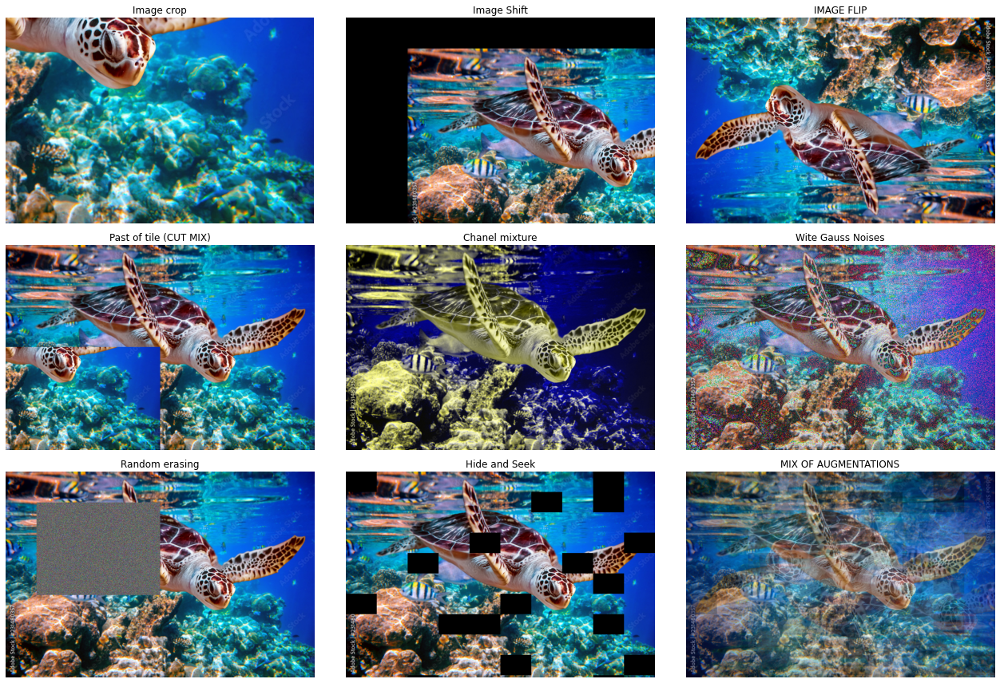

In [21]:
image = np.array(Image.open('image.png'))

fig,axs = plt.subplots(3,3,figsize=(18,12))

w,h = image.shape[0],image.shape[1]

#1. CROP = CUT
cut = image[w//2:,h//2:,:]
axplot(cut, axs[0,0], 'Image crop')

#2. IMAGE SHIFT
image_shift = np. copy(image)
image_shift[100:,200:,:] = image[:-100,:-200,:]
image_shift[:100,:,:] = 0
image_shift[:,:200,:] = 0
axplot(image_shift, axs[0,1], 'Image Shift')

#3. IMAGE FLIP
flip = np.copy(image)[::-1,::-1,:]
axplot(flip, axs[0,2], 'IMAGE FLIP' )

#4. PAST TAIL INTO IMAGE
past = np.copy(image)
past[w//2:,:h//2,:] = cut
axplot(past, axs[1,0], 'Past of tile (CUT MIX)' )

#5. CHANNEL MIXTURE
chanel_mixture = np. copy(image)
chanel_mixture[:,:,2],chanel_mixture[:,:,1] = 0.8*chanel_mixture[:,:,1],chanel_mixture[:,:,0]
axplot(chanel_mixture, axs[1,1], 'Chanel mixture' )

#6. ADD NOISES
var  = 300
gauss_noise = np.random.normal(0,np.sqrt(var),image.shape).astype('uint8')
gauss = image + gauss_noise
axplot(gauss, axs[1,2], 'Wite Gauss Noises' , True)

#7. RANDOM ERASING 
image_erase  = np.copy(image)
mean, var = np.mean(image), 1000
w_erase, h_erase = 300,400
gauss_noise  = np.random.normal(mean,np.sqrt(var),(w_erase,h_erase,image.shape[2])).astype('uint8')
image_erase[100:w_erase+100,100:h_erase+100,:] = gauss_noise
axplot(image_erase, axs[2,0], 'Random erasing' , True)

#8. HIDE AND SEEK OF IMAGE
scale_pathe,n_hides  = 10, 20
hs_ = np.copy(image)
w_path, h_path = w//scale_pathe, h//scale_pathe
w_hides = np.random.choice(np.arange(0, w, w_path),size = n_hides)
h_hides = np.random.choice(np.arange(0, h, h_path),size = n_hides)
for w_, h_ in zip(w_hides, h_hides):
    hs_[w_:w_+w_path,h_:h_+h_path,:] = 0
axplot(hs_, axs[2,1], 'Hide and Seek' , True)

#9. MIX OF AUGMENTATIONS
image_ = np.copy(image).astype(float)
#weights
w = np.asarray([3,2,1.8,3,2.2])
w /= w.sum()
image_ = (image*w[0] + hs_*w[1] + chanel_mixture *w[2] + flip *w[3] + image_shift*w[4])
axplot(image_, axs[2,2], 'MIX OF AUGMENTATIONS' , True, finish=True ) 

In addition, it is valuable to learn how different types of noise look like.
First, we can make it from scratch, using numpy

c:\users\ronkin\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:31: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
c:\users\ronkin\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:34: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


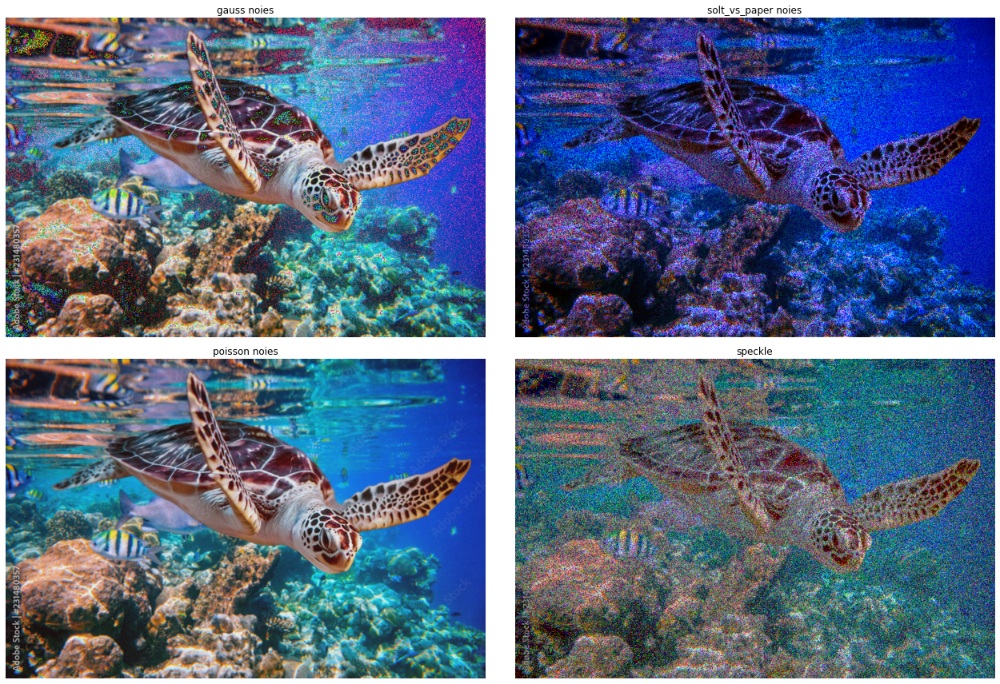

In [25]:
def standardize(image):
    image_ = np.copy(image).astype(float)
    image_ = 255*(image_ - image_.min())/(image_.max()-image_.min())
    image_ = image_.astype(np.uint8)
    return image_

image = np.array(Image.open('image.png'))

var = 100
mean = 0

#gauss
gauss_noise = np.random.normal(mean,np.sqrt(var),image.shape).astype('uint8')
gauss = standardize(image+gauss_noise)

#speckle
var = 3
gauss_noise = np.random.normal(mean,np.sqrt(var),image.shape).astype('uint8')
speckle = standardize(image + image * gauss_noise)

#poisson
poisson = standardize(image + np.random.poisson(var*10,image.shape)) 


#solt_and_paper
solt_vs_paper = 0.5
amount = 0.5
s_and_p = np.copy(image)

coords_salt = [np.random.randint(0, i - 1, int(amount * image.size * solt_vs_paper)) for i in image.shape]
s_and_p[coords_salt] = 1

coords_pepper = [np.random.randint(0, i - 1, int(amount* image.size * (1. - solt_vs_paper))) for i in image.shape]
s_and_p[coords_pepper] = 0
s_and_p = standardize(s_and_p)

_,axs = plt.subplots(2,2,figsize=(18,12))
axplot(gauss,  axs[0,0],'gauss noies')
axplot(s_and_p,axs[0,1],'solt_vs_paper noies')
axplot(poisson,axs[1,0],'poisson noies')
axplot(speckle,axs[1,1],'speckle',finish=True)


Additionally, it can be made using library skimage

<Figure size 1296x864 with 0 Axes>

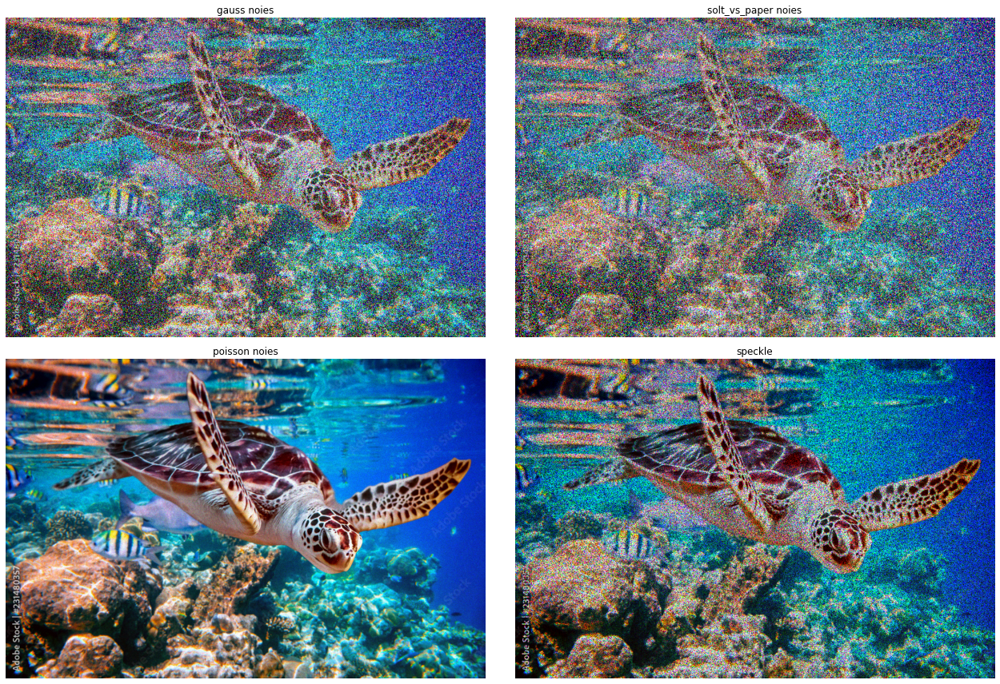

In [26]:
from skimage.util import random_noise

image = np.array(Image.open('image.png'))

s_and_p = random_noise(image, mode='s&p',salt_vs_pepper =0.5, amount = 0.5)
gauss   = random_noise(image, mode='gaussian',var = 0.3)
poisson = random_noise(image, mode='poisson',clip =0.1)
speckle = random_noise(image, mode='speckle',var = 0.7)

plt.figure(figsize=(18,12))
_,axs = plt.subplots(2,2,figsize=(18,12))
axplot(gauss,  axs[0,0],'gauss noies')
axplot(s_and_p,axs[0,1],'solt_vs_paper noies')
axplot(poisson,axs[1,0],'poisson noies')
axplot(speckle,axs[1,1],'speckle',finish=True)

Actually you may generate image by you self as matrix

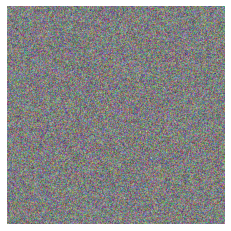

In [29]:
image = np.random.randint(0,255,(512,512,3))
axplot(image)

### Exercise 2
1. draw some figures  and text using pillow  on the generated from numpy image. 
2. Make at least 5 augmentation (processing operations) for any image (e.g. from exercise 1) using numpy.

## Study OpenCV

Check if you have `opencv`, either install it, using official documentation https://pypi.org/project/opencv-python/
* Option 1 - Main modules package: 
  ```pip install opencv-python```
* Option 2 - Full package (contains both main modules and contrib/extra modules):
  ```pip install opencv-contrib-python```
  (check contrib/extra modules listing from OpenCV documentation)

In [30]:
import cv2

The first thing we need is to open the image

In [31]:
image_url = 'https://as2.ftcdn.net/v2/jpg/02/31/48/03/1000_F_231480357_TGpMz4r5HSFAlm43FkZ366FjFZuuoRA8.jpg'
urllib.request.urlretrieve(image_url,"image.png")

image = cv2.imread("image.png")
(h, w, d) = image.shape
print("width={}, height={}, depth={}".format(w, h, d))

width=1000, height=667, depth=3


Please note that in opencv order of shapes: width, height, depth (channels).

In [35]:
image = cv2.imread("image.png")
print(f"OPENCV: {image.shape}, TYPE: {type(image)}")

image = Image.open("image.png")
print(f"PIL: {image.size}, TYPE: {type(image)}")

image = Image.open("image.png")
print(f"NumPY AFTER PIL: {np.asarray(image).shape}, TYPE: {type(image)}")


OPENCV: (667, 1000, 3), TYPE: <class 'numpy.ndarray'>
PIL: (1000, 667), TYPE: <class 'PIL.JpegImagePlugin.JpegImageFile'>
NumPY AFTER PIL: (667, 1000, 3), TYPE: <class 'PIL.JpegImagePlugin.JpegImageFile'>


You may open image using built-in method:
```python
cv2.imshow("Image", image)
cv2.waitKey(0)
cv2.destroyAllWindows()
```
however we reccomed not to use this way!

It would be better to open it with `plt` (`matplotlib` methods). However, the first thing we need to do when working with `OpenCV` images out of the library is to convert image format. This is due to opencv work with image in the `BGR` (inverse from `RGB`) format.

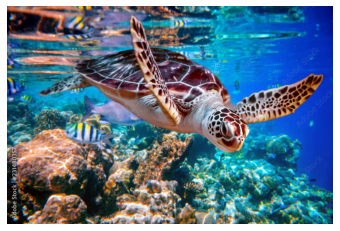

In [36]:
image = cv2.imread("image.png")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
axplot(image);

In addition, it would be valuable to look at how images look in the matrix form. Let us remind that usually, use 8-bit (0-255) format of integer digits in three channels to encode the digital images. Thus, each channel can be seen separately as a matrix.

(667, 1000, 3)
[[ 83  90 100 ...   1   1   2]
 [ 89  94 105 ...   1   1   2]
 [ 96 101 111 ...   1   1   1]
 ...
 [ 10  10  10 ...  14  13  10]
 [ 10  10  10 ...  15  14  13]
 [ 10  10  10 ...  16  16  15]]


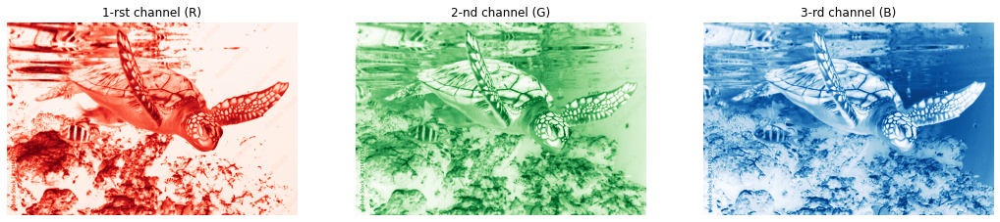

In [37]:
print(image.shape)
print(image[:,:,0])
# plt.matshow(image[:,:,0])
# plt.show();
plt.figure(figsize=(18,6));
plt.subplot(1,3,1)
plt.imshow(image[:,:,0],cmap="Reds")
plt.title('1-rst channel (R)'); plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(image[:,:,1],cmap="Greens")
plt.title('2-nd channel (G)'); plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(image[:,:,2],cmap="Blues")
plt.title('3-rd channel (B)'); plt.axis('off')
plt.show();

However, in fact, it would be better to show each channel in grey scale, because actually, digit value is intensity.

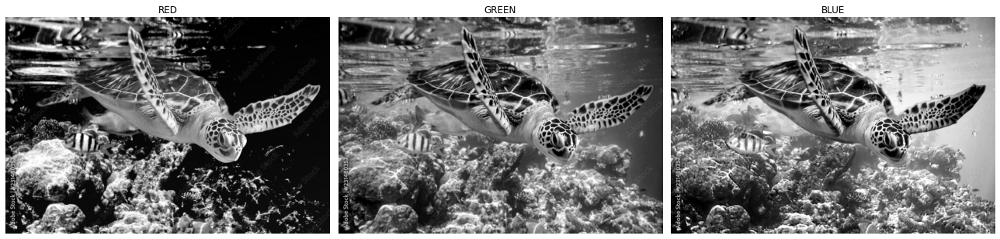

In [41]:
fig,axs = plt.subplots(1,3,figsize=(18,6));
axplot(image[:,:,0],axs[0],'RED')
axplot(image[:,:,1],axs[1],'GREEN')
axplot(image[:,:,2],axs[2],'BLUE',finish=True)

As you probably know, RGB is not the alone format, below is shown another variant - HSV (hue, saturation, value of intensity
)

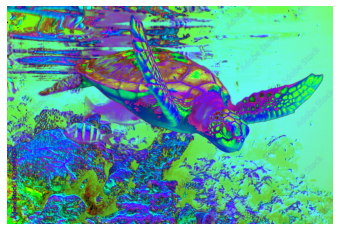

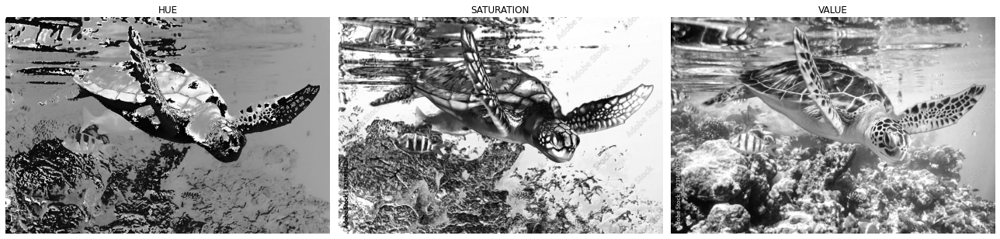

In [43]:
image = cv2.imread("image.png")
image=cv2.cvtColor(image,cv2.COLOR_BGR2HSV)
plt.imshow(image); plt.axis('off')
plt.show();

fig,axs = plt.subplots(1,3,figsize=(18,6));
axplot(image[:,:,0],axs[0],'HUE')
axplot(image[:,:,1],axs[1],'SATURATION')
axplot(image[:,:,2],axs[2],'VALUE',finish=True)


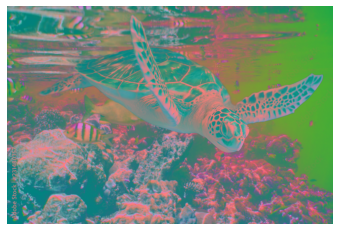

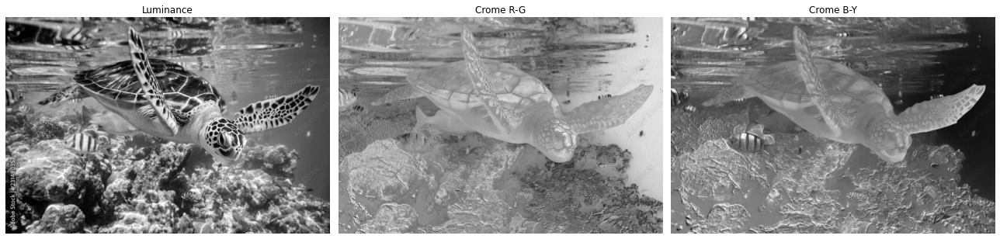

In [68]:
image = cv2.imread("image.png")
image=cv2.cvtColor(image,cv2.COLOR_BGR2LAB)
plt.imshow(image); plt.axis('off')
plt.show();

fig,axs = plt.subplots(1,3,figsize=(18,6));
axplot(image[:,:,0],axs[0],'Luminance')
axplot(image[:,:,1],axs[1],'Crome R-G')
axplot(image[:,:,2],axs[2],'Crome B-Y',finish=True)

Actually, we can open images straight in the required format rather than make additional preprocessing. It would be valuable to open the image in the gray-scale form.

(667, 1000)


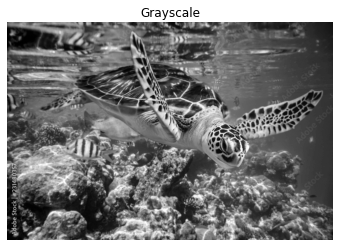

In [46]:
image = cv2.imread("image.png",cv2.IMREAD_GRAYSCALE)
print(image.shape)
axplot(image, title= 'Grayscale');

`OpenCV` contains almost all classical operations applied in the computer vision, below you may find several examples of simple operations.

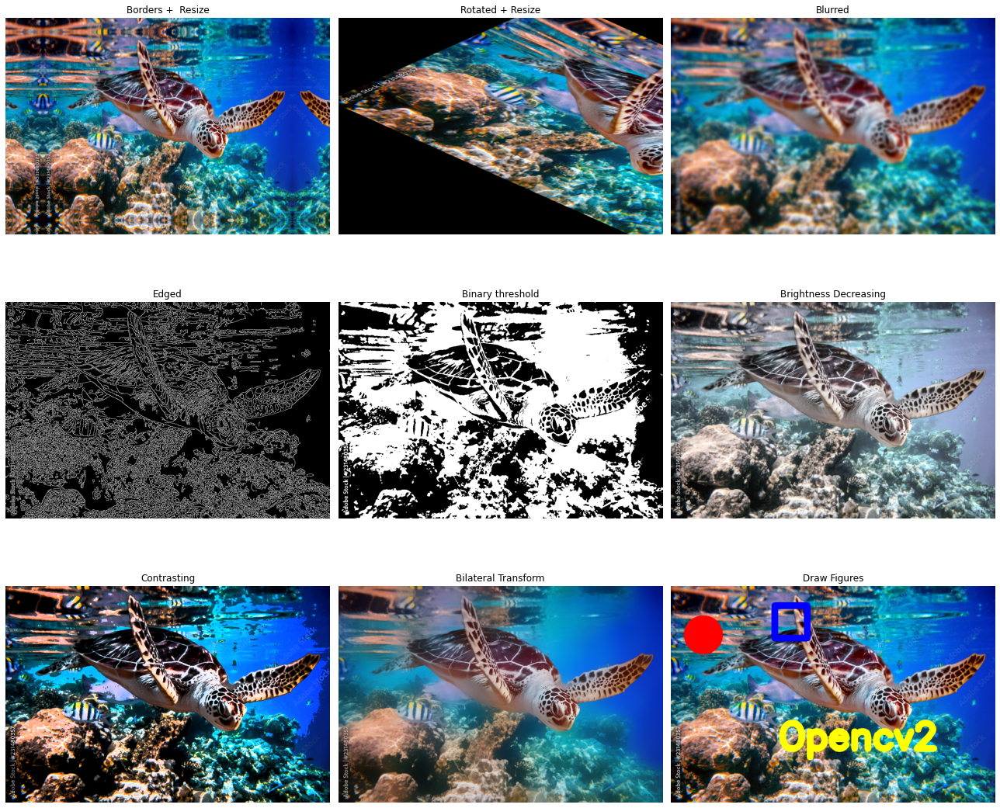

In [69]:
image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

fig, axs = plt.subplots(3,3, figsize=(18,16))

w = image.shape[0]
h = image.shape[1]
center = (w // 2, h // 2)

# 1. MAKE BORDERS AND REZIE THE IMAGE
top, bottom, left, right = 50,50,150,150
reflect = cv2.copyMakeBorder(image, top, bottom, left, right, cv2.BORDER_REFLECT)
axplot(cv2.resize(reflect,(h,w)), axs[0,0], 'Borders +  Resize' )

# 2. ROTATE AND RESIZE THE IMAGE
M = cv2.getRotationMatrix2D(center, -45, 1.0)
rotated = cv2.warpAffine(image, M, (w, h))
axplot(cv2.resize(rotated,(h,w)), axs[0,1], 'Rotated + Resize' )

# 3. BLURRE THE IMAGE
blurred = cv2.GaussianBlur(image, (21, 21), 0)
axplot(blurred, axs[0,2], 'Blurred' )

# 4. SEARCH EDGES IN THE IMAGE
edged = cv2.Canny(image, 30, 150)
axplot(edged, axs[1,0], 'Edged' )

# 5. BINARIZING THE IMAGE
_,threshold = cv2.threshold(cv2.cvtColor(image, cv2.COLOR_BGR2GRAY), 100, 255, cv2.THRESH_BINARY)
axplot(threshold, axs[1,1], 'Binary threshold' )

# 6. BRIGHTNESS CHANGES OF THE IMAGE
values = (1,0.3,1)
hsv  = cv2.cvtColor(image, cv2.COLOR_RGB2HSV).astype(float)
hsv *= values 
rgb_ = cv2.cvtColor(hsv.astype(np.uint8), cv2.COLOR_HSV2RGB)
# bright  = cv2.convertScaleAbs(image, beta=70)
axplot(rgb_, axs[1,2], 'Brightness Decreasing', True )

# 7. CONTRAST THE IMAGE  
contrast = 60
im_ = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
im_[:,:,2] = [[max(pixel - contrast, 0) 
                 if pixel < 190 else min(pixel + contrast, 255) for pixel in row] 
                 for row in im_[:,:,2]]
im_= cv2.cvtColor(im_, cv2.COLOR_HSV2BGR)
axplot(im_, axs[2,0], 'Contrasting' )

# 8. BILATERAL  TRANSFORMATION OF THE IMAGE
d, sigmaColor, sigmaSpace = 75,125,125
im = cv2.bilateralFilter(image, d,sigmaColor,sigmaSpace)
axplot(im, axs[2,1], 'Bilateral Transform' )

# 9. DRAW FIGURES IN THE IMAGE
draw_figures = image.copy()
cv2.rectangle(draw_figures, (320, 60), (420, 160), (0, 0, 255), 20)
cv2.circle(draw_figures, (100, 150), 60, (255, 0, 0), -1)
cv2.putText(draw_figures, "Opencv2 ", center, cv2.FONT_HERSHEY_SIMPLEX, 3.7, (255, 255, 0), 20)
axplot(draw_figures, axs[2,2], 'Draw Figures', finish=True )


However, besides methods studied in Pillow, OpenCV has a lot of more specific methods.<br> For instance, below you may see how to make borders.

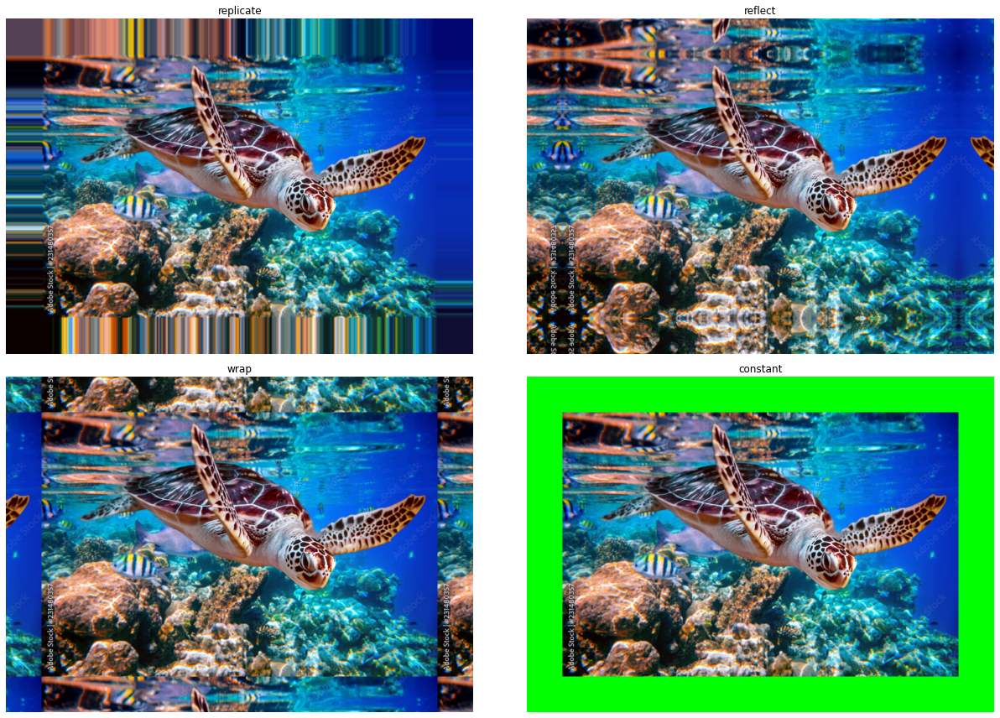

In [76]:
image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

bs = 90 #border_size

replicate  = cv2.copyMakeBorder(image,bs,bs,bs,bs,cv2.BORDER_REPLICATE)
reflect    = cv2.copyMakeBorder(image,bs,bs,bs,bs,cv2.BORDER_REFLECT)
wrap       = cv2.copyMakeBorder(image,bs,bs,bs,bs,cv2.BORDER_WRAP)
constant   = cv2.copyMakeBorder(image,bs,bs,bs,bs,cv2.BORDER_CONSTANT,value=(0,255,0))

_,axs = plt.subplots(2,2, figsize=(18,12))
axplot(replicate,axs[0,0],'replicate')
axplot(reflect,axs[0,1],'reflect')
axplot(wrap,axs[1,0],'wrap')
axplot(constant,axs[1,1],'constant',finish=True)


In the previous example, we used a global threshold value. 
But it may not be good in all the conditions where the image has different lighting conditions in different areas. 

In that case, we go for adaptive thresholding. In this, the algorithm calculates the threshold for small regions of the image. So we get different thresholds for different regions of the same image.

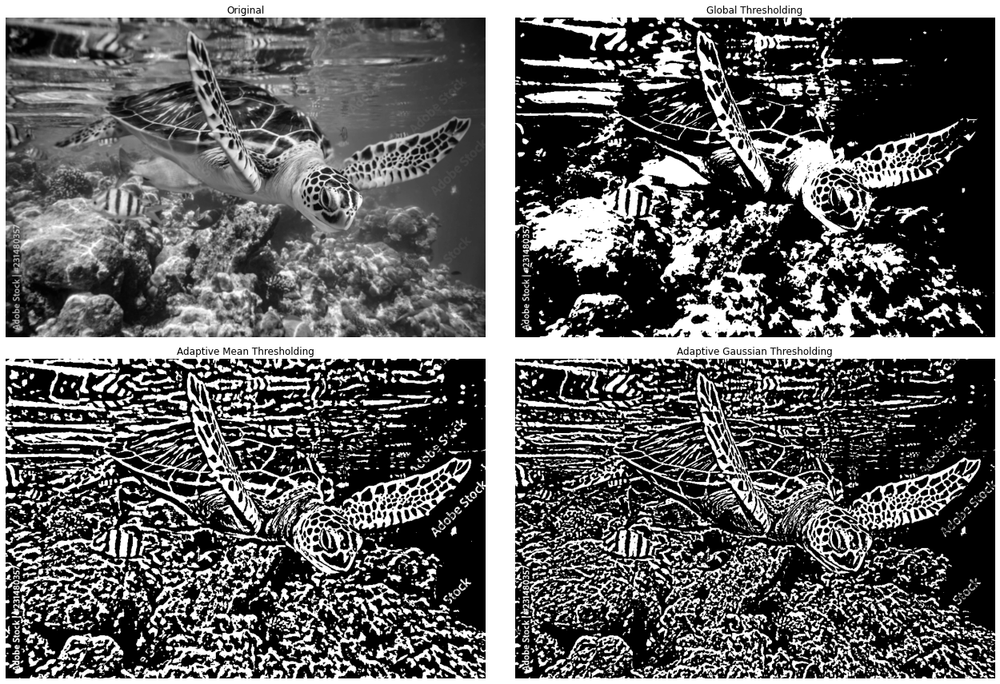

In [77]:
image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

ret,th1 = cv2.threshold(image,127,255,cv2.THRESH_BINARY)

th2 = cv2.adaptiveThreshold(image,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,21,-5)

th3 = cv2.adaptiveThreshold(image,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,21,-5)


_,axs = plt.subplots(2,2, figsize=(18,12))
axplot(image,axs[0,0],'Original')
axplot(th1,axs[0,1],'Global Thresholding')
axplot(th2,axs[1,0],'Adaptive Mean Thresholding')
axplot(th3,axs[1,1],'Adaptive Gaussian Thresholding', finish=True)


Image Mixing

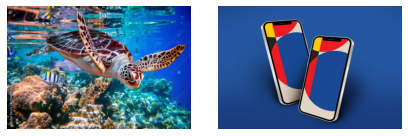

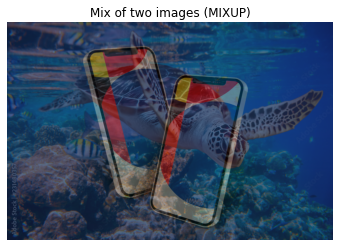

In [38]:
image1_url = 'https://as2.ftcdn.net/v2/jpg/02/31/48/03/1000_F_231480357_TGpMz4r5HSFAlm43FkZ366FjFZuuoRA8.jpg'
urllib.request.urlretrieve(image1_url,"image1.png")
image1 = cv2.imread("image1.png",cv2.IMREAD_COLOR)
image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)


image2_url = 'https://as2.ftcdn.net/jpg/04/46/10/77/1024W_F_446107734_NaiNx4Qxq1bT4ipU1vGohw1dtU9kOWpx_NW1.jpg'
urllib.request.urlretrieve(image2_url,"image2.png")
image2 = cv2.imread("image2.png",cv2.IMREAD_COLOR)
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

image2 = cv2.resize(image2, image1.shape[:2][::-1])

fig,axs = plt.subplots(1,2, figsize=(6,2))
axplot(image1,axs[0]); axplot(image2,axs[1], finish=True )

mix = cv2.addWeighted(image1,0.3,image2,0.4,0)
axplot(mix,title='Mix of two images (MIXUP)');

### Exercise 3 
1. Select any image and try to make at least 5 operations with it using opencv.

## Histogram processing

Ley's look on how working with hitograms using `OpenCV`.

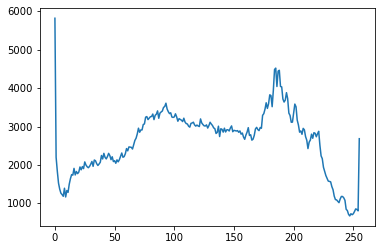

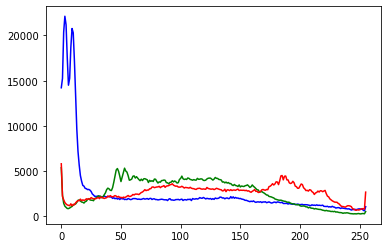

In [80]:
image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


hist = cv2.calcHist([image],[2],None,[256],[0,256]) 
plt.plot(hist); plt.show()

color = ('b','g','r')

for chanel_i, color_i in enumerate(color):
    hist = cv2.calcHist([image],[chanel_i],None,[256],[0,256]) 
    plt.plot(hist, c= color_i)

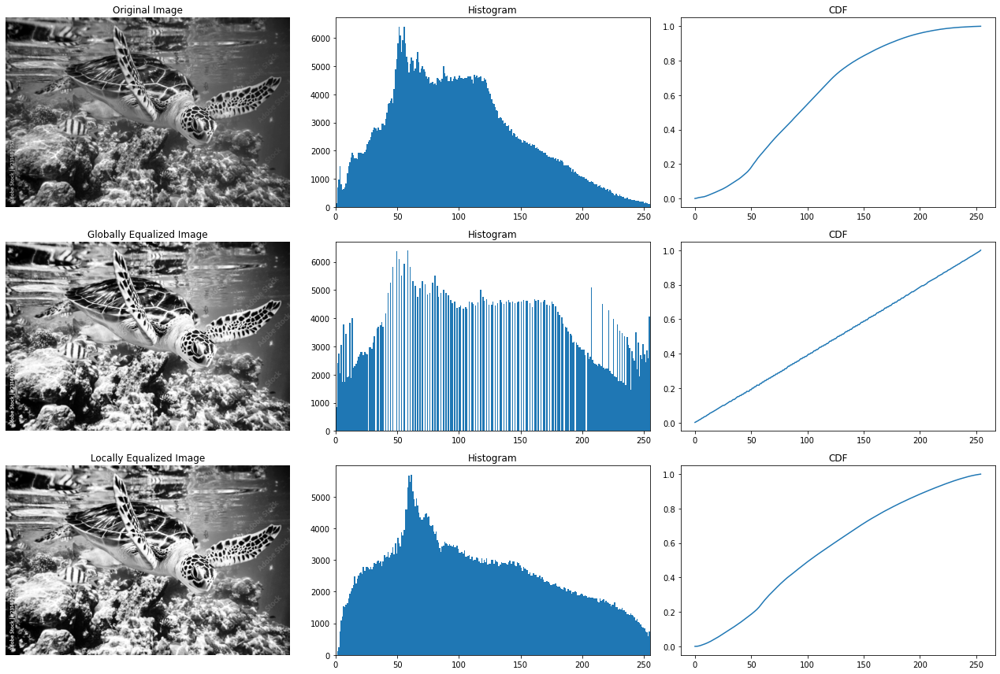

In [39]:
img = cv2.imread("image.png",cv2.IMREAD_GRAYSCALE )

# GLOBAL EUQALIZING
equ = cv2.equalizeHist(img)

# LOCAL EUQALIZING (ADAPTIVE)
clahe = cv2.createCLAHE(clipLimit = 2.0,tileGridSize = (16,16))
clahed = clahe.apply(img)

fig,axs = plt.subplots(3,3,figsize=(18,12))

#ORIGINAL IMAGE
axplot(img, axs[0,0], 'Original Image' )
b, bins, patches = axs[0,1].hist(img.flatten(), 255)
axs[0,1].set_xlim([0,255]); axs[0,1].set_title('Histogram')
axs[0,2].plot(np.cumsum(b)/np.sum(b)); axs[0,2].set_title('CDF')

#GLOBALLY EQUALIZED IMAGE
axplot(equ, axs[1,0], 'Globally Equalized Image' )
b, bins, patches = axs[1,1].hist(equ.flatten(), 255)
axs[1,1].set_xlim([0,255]); axs[1,1].set_title('Histogram')
axs[1,2].plot(np.cumsum(b)/np.sum(b)); axs[1,2].set_title('CDF')

#LOCALLY EQUALIZED IMAGE
axplot(equ, axs[2,0], 'Locally Equalized Image' )
b, bins, patches = axs[2,1].hist(clahed.flatten(), 255)
axs[2,1].set_xlim([0,255]); axs[2,1].set_title('Histogram')
axs[2,2].plot(np.cumsum(b)/np.sum(b)); axs[2,2].set_title('CDF')

plt.tight_layout()
plt.show()


### Exercise 4 
1. Learn histogram of binary image, 
2. Learn the histogram of the image, obtained with THRESH_TOZERO and THRESH_TRUNC threshold functions.
3. Select at least 3 operations from the previous section (simple operations in the opencv) and learn histogram for all of them. Do not forget to transform images to gray-scale.
4. Learn how histogram change depends on the noise influence value.


## Convolution operation

Convolutions are mathematical operations between two functions that create a third function. In image processing, this operation is carried out by passing the spatial shift of one image and the operation of multiplying another image.
The kernels define the size of the convolution, the weights applied to it, and an anchor point usually positioned at the centre of the kernels.
<br> Convolution is the main operation in most computer vision methods. For the first let's try to make it in the numpy.
> *Note* For obtaining the image of the same size we will need to make zero-padding of the input image to the extra size.

In [83]:
def convolve2D(image, kernel):
    
    kernel = np.asarray(kernel)
    
    # for obtain 
    image_pad = np.pad(image,pad_width=(kernel.shape[0]//2-1, kernel.shape[1]//2-1 ),mode='constant')
    
    output    = np.zeros_like(image_pad)
    
    for x in range(kernel.shape[0]//2, image_pad.shape[0]-kernel.shape[0]):
        for y in range(kernel.shape[1]//2, image_pad.shape[1]-kernel.shape[1]):
            
            image_path = image[x: x + kernel.shape[1], 
                               y: y + kernel.shape[0]]

            output[x, y] = np.sum(kernel*image_path)


    return output

(667, 1000) (667, 1000)


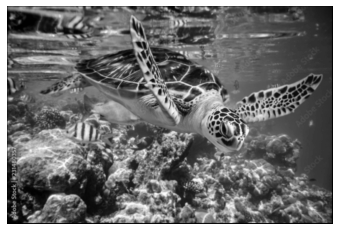

In [85]:
image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

kernel = np.asarray([[1,1,1],[1,1,1],[1,1,1]])/9

out = convolve2D(image,kernel)

axplot(out)
print(out.shape, image.shape)

Now let's test the same operation from opencv

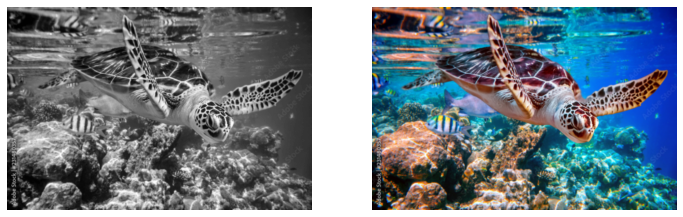

(667, 1000) (667, 1000, 3)


In [87]:
image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image_rgb  = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

kernel = np.asarray([[1,1,1],[1,1,1],[1,1,1]])/9

out_gray = cv2.filter2D(src=image_gray, ddepth=-1, kernel=kernel)
out_rgb  = cv2.filter2D(src=image_rgb,  ddepth=-1, kernel=kernel)
plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(out_gray, 'gray'); plt.axis('off')
plt.subplot(1,2,2); plt.imshow(out_rgb); plt.axis('off')
plt.show();
print(out_gray.shape, image.shape)

Let's study some simple filters.


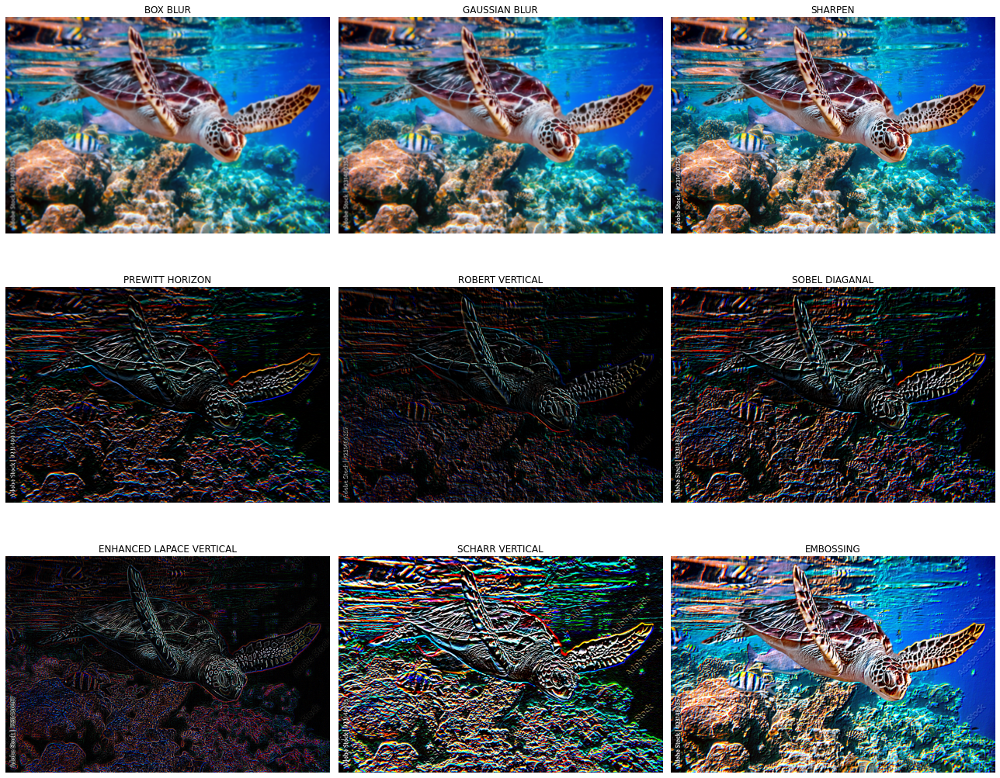

In [88]:
image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
fig, axs = plt.subplots(3,3, figsize=(18,15))

#1. BOX BLURRING 
kernel = np.ones(25).reshape(-1,5)
kernel = np.asarray(kernel)/np.sum(np.abs(kernel))
boxblur  = cv2.filter2D(src=image,  ddepth=-1, kernel=kernel)
axplot(boxblur, axs[0,0], 'BOX BLUR' )

#2. GAUSSIAN BLURRING
kernel = [[2, 4,   5,  4, 2],
          [4, 9,  12,  9, 4],
          [5, 12, 15, 12, 5],
          [4, 9,  12,  9, 4],
          [2, 4,   5,  4, 2]]
kernel = np.asarray(kernel)/np.sum(np.abs(kernel))
gaussian_blure  = cv2.filter2D(src=image,  ddepth=-1, kernel=kernel)
axplot(gaussian_blure, axs[0,1], 'GAUSSIAN BLUR' )

#3. SHARPEN FILTER
kernel = np.array([[1, 4,     6,  4, 1],
                   [4, 16,   24, 16, 4],
                   [6, 24, -476, 24, 6],
                   [4, 16,   24, 16, 4],
                   [1, 4,     6,  4, 1]])
kernel   = np.asarray(kernel)/np.sum(kernel)
sharpen  = cv2.filter2D(src=image,  ddepth=-1, kernel=kernel)
axplot(sharpen, axs[0,2], 'SHARPEN' )

#4. PREWITT EDGE OPERATOR IN HORIZON 
kernel = np.array([[-1, -1, -1],
                   [ 0,  0,  0],
                   [ 1,  1,  1]])
prewitt_h  = cv2.filter2D(src=image,  ddepth=-1, kernel=kernel)
axplot(prewitt_h, axs[1,0], 'PREWITT HORIZON' )

# 5. ROBERT VERTICAL
kernel = 2.5*np.array([[0, 1],[-1,0]])
robert_y  = cv2.filter2D(src=image,  ddepth=-1, kernel=kernel)
axplot(robert_y, axs[1,1], 'ROBERT VERTICAL' )

#6. SOBEL EDGE DETECTION OPERATOR IN DIAGANAL  
kernel = np.array([[-2, -1,  0],
                   [-1,  0,  1],
                   [ 0,  1,  2]])
sobel_d  = cv2.filter2D(src=image,  ddepth=-1, kernel=kernel)
axplot(sobel_d, axs[1,2], 'SOBEL DIAGANAL' )

#7. LAPACE VERTICAL
kernel = 1.3*np.array([[1,  1, 1],
                       [1, -8, 1], 
                       [1, 1,  1]])
Laplace_v  = cv2.filter2D(src=image,  ddepth=-1, kernel=kernel)
axplot(Laplace_v, axs[2,0], 'ENHANCED LAPACE VERTICAL' )

#8. SCHARR EDGE OPERATOR IN VERTICAL 
kernel = np.array([[-3, -10, -3],
                   [ 0,  0,   0],
                   [ 3,  10,  3]])
scharr_y  = cv2.filter2D(src=image,  ddepth=-1, kernel=kernel)
axplot(scharr_y, axs[2,1], 'SCHARR VERTICAL' )

# 9. EMBOSSING filter
kernel = np.array([[-2, -1, 0],
                   [-1,  1, 1],
                   [ 0,  1, 2]])
kernel = np.asarray(kernel)/np.sum(kernel)
emboss = cv2.filter2D(src=image,  ddepth=-1, kernel=kernel)
axplot(emboss, axs[2,2], 'EMBOSSING', finish=True  )


# SOBEL V: [[-1, 0,  1],[-2, 0,  2], [-1, 0,  1]]
# SOBEL H: [[-1, -2,  -1],[0, 0, 0], [1, 2,  1]]
#ROBERT X: [[1, 0],[0,-1]]
#ROBERT Y: [[0, 1],[-1,0]]
#LAPACE X: [[-1, 2,-1],[2, -4, 2], [-1, 2,  -1]]
#LAPACE Y: [[1,1,1],[1, -8, 1], [1, 1, 1]]
#LAPACE HV: [[0, -1, 0],[-1, -4, -1], [0, -1, 0]]
#LAPACE D:  [[-1, 0,-1],[0, 4, 0], [-1, 0, -1]]
#LINE 0,  180 DEGREE: [[-1,-1,-1],[2, 2,  2],[-1,-1,-1]]
#LINE 45, 225 DEGREE: [[-1,-1, 2],[-1,2, -1],[2, -1,-1]]
#LINE 90, 270 DEGREE: [[-1,2, -1],[-1, 2,-1],[-1, 2,-1]]
#LINE 135,315 DEGREE: [[2,-1, -1],[-1,2,-1],[-1, -1, 2]]
# Gaussian Blur 5x5 [[1, 4, 6, 4, 1],[4, 16, 24, 16, 4],[6, 24, 36, 24, 6],[4, 16, 24, 16, 4],[1, 4, 6, 4, 1]]
# Gaussian Blur 3x3 [[1, 2, 1], [2, 4, 2],[1, 2, 1]]
# Unsharp 3x3 [[ 0, -1,   0],[-1,  5,  -1],[ 0, -1,   0]]
# Embossing - South West: [[0,-1,-1], [1, 0,-1],[1,1, 0]]
# Embossing - South East: [[-1,-1,0], [-1,0, 1],[0,1, 1]]
# Embossing - North West: [[1,0,0],   [0, 0, 0],[0,0,-1]]
#EMBOSSING 5x5 [[0,0,0,0,0],[0,-2,-1,0,0],[0,-1,1,1,0],[0,0,1,2,0],[0,0,0,0,0]]

Actually, `OpenCV` contains some filters as built in functions.

Linear filters.

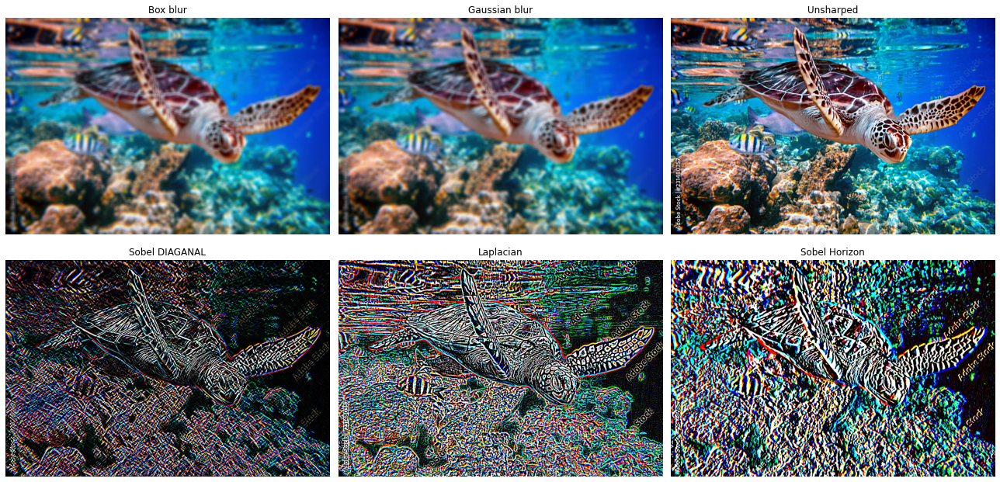

In [90]:
image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
fig, axs = plt.subplots(2,3, figsize=(18,9))

#1. BOX BLURRING 
blurred = cv2.boxFilter(image, -1, (11,11))
axplot(blurred, axs[0,0], 'Box blur' )

#2. Gaussian BLURRING 
blurred = cv2.GaussianBlur(image, (11, 11), 12.5)
axplot(blurred, axs[0,1], 'Gaussian blur' )

#3. Sobel Horizon 
sobel_horizontal = cv2.Sobel(image, -1, 1, 0, ksize=5)
axplot(sobel_horizontal, axs[1,2], 'Sobel Horizon' )

# Sobel Vertical 
# sobel_vertical = cv2.Sobel(image, -1, 0, 1, ksize=5)
# axplot(sobel_vertical, axs[1,1], 'Sobel Vertical' )

#4. Sobel DIAGANAL
sobel_diag = cv2.Sobel(image, -1, 1, 1, ksize=5)
axplot(sobel_diag, axs[1,0], 'Sobel DIAGANAL' )

#5. Laplacian
laplacian = cv2.Laplacian(image, -1,  ksize=5)
axplot(laplacian, axs[1,1], 'Laplacian' )

#6. Unsharped IMAGE
smoothed = cv2.GaussianBlur(image, (9, 9), 10) 
unsharped = cv2.addWeighted(image, 1.5, smoothed, -0.5, 0)
axplot(unsharped, axs[0,2], 'Unsharped', finish=True  )



Non-linear filters

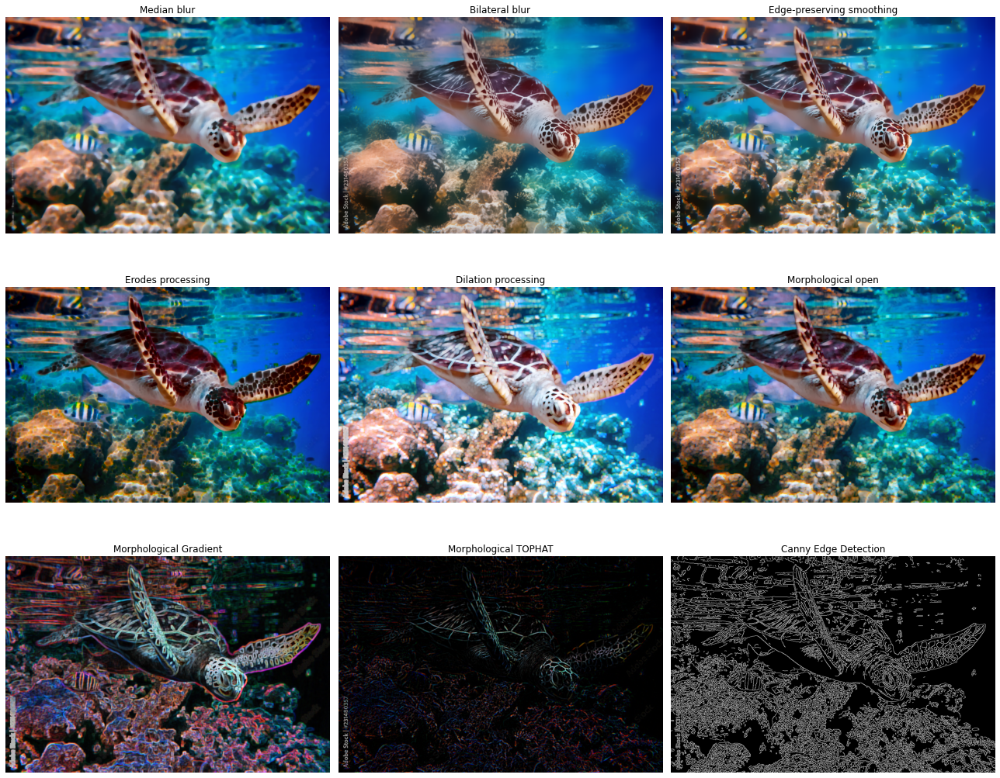

In [91]:
image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
fig, axs = plt.subplots(3,3, figsize=(18,15))

#1. Median BLURRING 
blurred = cv2.medianBlur(image, 11)
axplot(blurred, axs[0,0], 'Median blur' )

#2. Bilateral BLURRING 
bilateral  = cv2.bilateralFilter(image,50,125,125)
axplot(bilateral, axs[0,1], 'Bilateral blur' )

#3. Edge-preserving smoothing Filter
im_ = cv2.edgePreservingFilter(image, sigma_s=60, sigma_r=0.4)
axplot(im_, axs[0,2], 'Edge-preserving smoothing' )

#4. Erodes Filter using  structuring element
kernel = np.ones((5,5),dtype = np.uint8)
eroded = cv2.erode(image, kernel, iterations=1)
axplot(eroded, axs[1,0], 'Erodes processing' )

#5. Dilation Filter using  structuring element 
kernel = np.ones((5,5),dtype = np.uint8)
dialtion = cv2.dilate(image, kernel, iterations=1)
axplot(dialtion, axs[1,1], 'Dilation processing' )

#6. MORPHOLOGICAL OPEN (Erodes then Dilation) # cv2.MORPH_CLOSE  Dilation followed by Erosion 
kernel = np.ones((5,5),dtype = np.uint8)
im_ = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
axplot(im_, axs[1,2], 'Morphological open' )

#7. MORPHOLOGICAL GRADIENT (erosion - dilation) cv2.MORPH_OPEN (in reverse way)
kernel = np.ones((5,5), np.uint8)
im_ = cv2.morphologyEx(image, cv2.MORPH_GRADIENT, kernel)
axplot(im_, axs[2,0], 'Morphological Gradient' )

#8. MORPHOLOGICAL TOP HAT ( image - Opening(image)) # cv2.MORPH_BLACKHAT (in reverse way) 
kernel = np.ones((5,5), np.uint8)
im_ = cv2.morphologyEx(image, cv2.MORPH_TOPHAT, kernel)
axplot(im_, axs[2,1], 'Morphological TOPHAT' )

#9. Canny Edge Detection 
canny  = cv2.Canny(image,125,175)
axplot(canny, axs[2,2], 'Canny Edge Detection', finish=True  )


Also let's try some transformation of iamges with opencv.

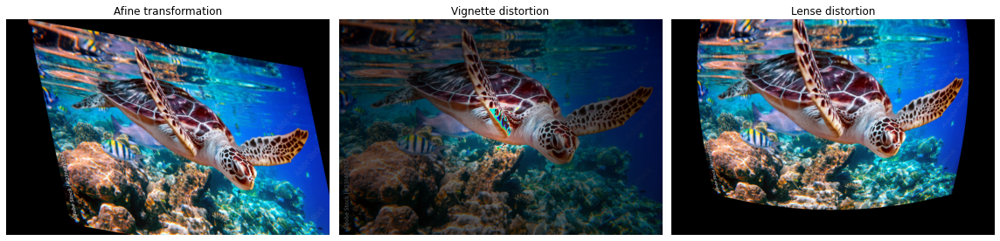

In [92]:
# AFINE TRANSFORMS OF THE IMAGE
def afine_transform(image):
    w,h = image.shape[:2]
    srcTri = np.array( [[0,  0], 
                        [w , 0], 
                        [0,  h]])

    dstTri = np.array([[w*0.1,  h*0.0], 
                       [w*0.95, h*0.1], 
                       [w*0.4,  h*0.95]])

    warp_mat = cv2.getAffineTransform(srcTri.astype(np.float32), dstTri.astype(np.float32))
    warp_dst = cv2.warpAffine(image, warp_mat, (image.shape[1], image.shape[0]))
    return warp_dst
#-------------------------------------------------
def vignette(image, alpha =0.5, sigma = 100 ):
    h, w = image.shape[:2]
    
    # generating vignette mask using Gaussian
    x_kernel = cv2.getGaussianKernel(w,sigma)
    y_kernel = cv2.getGaussianKernel(h,sigma)
    
    #generating resultant_kernel matrix
    res_kernel = y_kernel * x_kernel.T
    
    #creating mask and normalising by using np.linalg
    mask = 255 * res_kernel / np.linalg.norm(res_kernel)
    output = [out_ch * (alpha+(1-alpha)*mask) for out_ch in cv2.split(image)]
    return  np.asarray(output).transpose((1,2,0)).astype(np.uint8)

#-------------------------------------------------
def lense_distorition(image, focal_length = 7, distCoeff = [6e-5, 2e-9, 2e-3, 1e-6 ] ):
    h, w = image.shape[:2]
    # assume matrix for camera
    cam = np.eye(3,dtype=np.float32)
    cam[0,2], cam[1,2] = w/2, h/2  # define center x
    cam[0,0], cam[1,1] = focal_length, focal_length # define focal length for x and y
    # here the undistortion will be computed
    dst = cv2.undistort(image,cam,np.asarray(distCoeff))
    return dst 


image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
fig, axs = plt.subplots(1,3, figsize=(16,4))

axplot(afine_transform(image),   axs[0], 'Afine transformation' )
axplot(vignette(image,0.35),     axs[1], 'Vignette distortion' )
axplot(lense_distorition(image), axs[2], 'Lense distortion', finish=True  )

Also let us note that open cv contatins a lot of more complex filter-like operations
<!-- https://www.analyticsvidhya.com/blog/2021/07/an-interesting-opencv-application-creating-filters-like-instagram-and-picsart/ -->

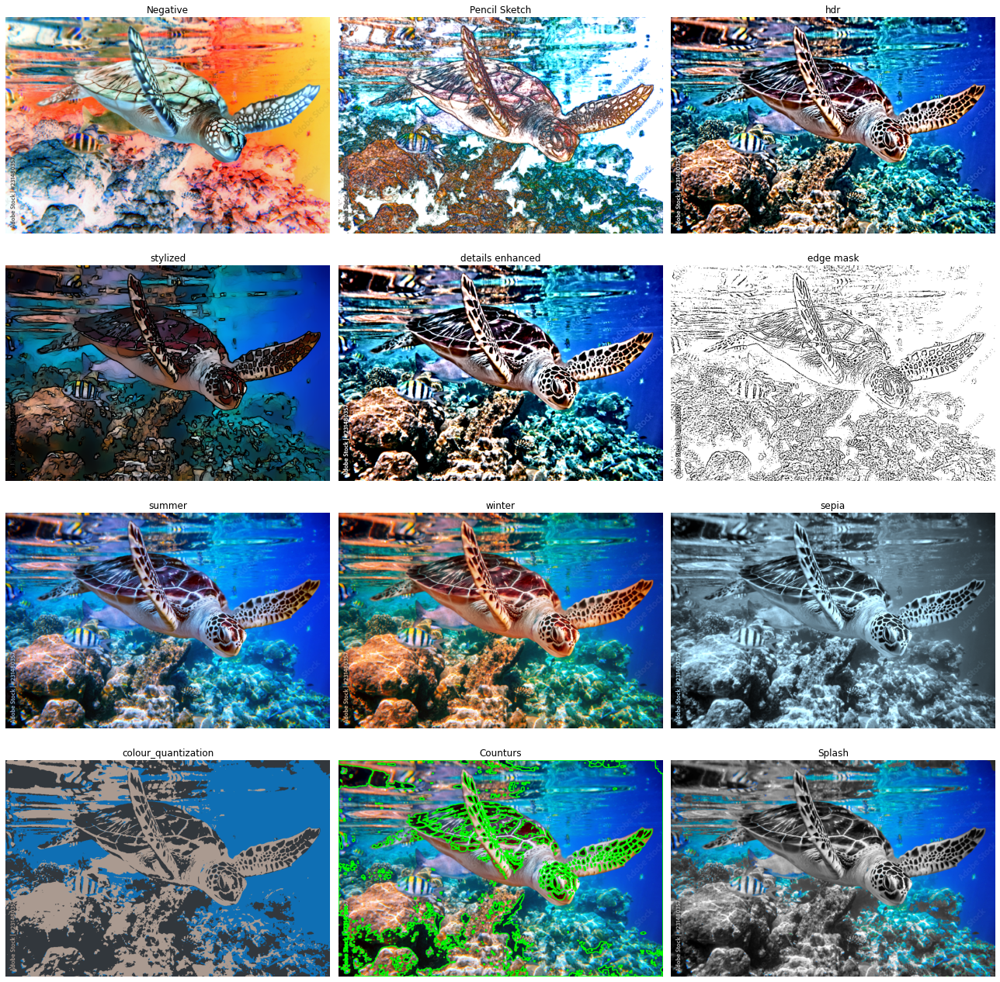

In [96]:
from scipy.interpolate import UnivariateSpline

#-------------------------------------------------
def counturs(image, threshold = 50, color = (0,255,0), thickness=2 ):
    im_ = np.copy(image )
    im_gray = cv2.cvtColor(im_,cv2.COLOR_BGR2GRAY)
    _,thresh = cv2.threshold(im_gray,threshold,255,cv2.THRESH_BINARY)
#     thresh = cv2.Canny(im_gray, threshold, 255)
    contours, _ = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
    im_ =  cv2.drawContours(im_,contours,-1,color,thickness = thickness)
    return im_ 

#-------------------------------------------------
def LookupTable(x, y):
    spline = UnivariateSpline(x, y)
    return spline(range(256))
                  
def summer(img):
    # summer
    increaseLookupTable = LookupTable([0, 64, 128, 256], 
                                      [0, 80, 160, 256])    
    decreaseLookupTable = LookupTable([0, 64, 128, 256], 
                                      [0, 50, 100, 256])
    blue_channel, green_channel,red_channel  = cv2.split(img)
    red_channel  = cv2.LUT(red_channel,  increaseLookupTable).astype(np.uint8)
    blue_channel = cv2.LUT(blue_channel, decreaseLookupTable).astype(np.uint8)
    summer_ = cv2.merge((blue_channel, green_channel, red_channel ))
    return summer_
#-------------------------------------------
def winter(img):
    increaseLookupTable = LookupTable([0, 64, 128, 256], [0, 80, 160, 256])
    decreaseLookupTable = LookupTable([0, 64, 128, 256], [0, 50, 100, 256])
    blue_channel, green_channel,red_channel = cv2.split(img)
    red_channel  = cv2.LUT(red_channel, decreaseLookupTable).astype(np.uint8)    
    blue_channel = cv2.LUT(blue_channel, increaseLookupTable).astype(np.uint8)

    out= cv2.merge((blue_channel, green_channel, red_channel))
    return out
   
#-------------------------------------------------
def sepia(img):
    img_sepia = np.array(img, dtype=np.float64) 
    # multipying image with special sepia matrix
    img_sepia = cv2.transform(img_sepia, 
                              np.matrix([[0.272, 0.534, 0.131],
                                         [0.349, 0.686, 0.168],
                                         [0.393, 0.769, 0.189]])) 
    return np.clip(img_sepia,0,255).astype(np.uint8)
#-------------------------------------------
def edge_mask(img, line_size=3, blur_value=3):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.medianBlur(gray, blur_value)
    edges = cv2.adaptiveThreshold(gray_blur, 255, 
                                  cv2.ADAPTIVE_THRESH_MEAN_C, 
                                  cv2.THRESH_BINARY, 
                                  line_size, 
                                  blur_value)
    return edges
#-------------------------------------------
def сolour_quantization(image,k=3):
    im_ = image.reshape((-1, 3)) 
    im_ = np.float32(im_) 
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 
                100, 0.001)
    compactness, label, center = cv2.kmeans(im_, k, None, 
                                            criteria, 1, 
                                            cv2.KMEANS_RANDOM_CENTERS)
    center = np.uint8(center)
    res = center[label.flatten()]
    res2 = res.reshape((image.shape))
    return res2
#---------------------------------------------------------
def splash(image, l, u ):
    
    def hsv(image, l, u):
        hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        lower = np.array([l,128,128]) # setting lower HSV value
        upper = np.array([u,255,255]) # setting upper HSV value
        mask = cv2.inRange(hsv, lower, upper) # generating mask
        return mask
    
    image_ = image.copy()
    res  = np.zeros_like(image)
    gray = cv2.cvtColor(image_, cv2.COLOR_BGR2GRAY)
    
    mask = hsv(image_, l, u)
    inv_mask = cv2.bitwise_not(mask)
    
    color_regions = cv2.bitwise_and(image_, image_, mask= mask) # regions in color
    gray_regions  = cv2.bitwise_and(gray, gray, mask= inv_mask) # regionsin gray
    
    res = cv2.merge((gray_regions,gray_regions,gray_regions)) # storing grayscale mask to all three slices

    res = cv2.bitwise_or(color_regions, res) # joining grayscale and color region
    
    return res

image = cv2.imread("image.png",cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
fig, axs = plt.subplots(4,3, figsize=(18,18))

inverse = cv2.bitwise_not(image)
axplot(inverse, axs[0,0], 'Negative' )

sk_gray, sk_color = cv2.pencilSketch(image, sigma_s=6, sigma_r=0.07, shade_factor=0.1)
axplot(sk_color, axs[0,1], 'Pencil Sketch' )

hdr = cv2.detailEnhance(image, sigma_s=12, sigma_r=0.15)
axplot(hdr, axs[0,2], 'hdr' )

im_ = cv2.stylization (image,   sigma_s = 20, sigma_r = 0.6) 
axplot(im_, axs[1,0], 'stylized' )

im_ = cv2.detailEnhance (image, sigma_s = 20, sigma_r = 0.5)
axplot(im_, axs[1,1], 'details enhanced' )

axplot(edge_mask(image), axs[1,2], 'edge mask' )
 
axplot(summer(image), axs[2,0], 'summer' ) 
axplot(winter(image), axs[2,1], 'winter' ) 
axplot(sepia(image), axs[2,2], 'sepia' )  

axplot(сolour_quantization(image), axs[3,0], 'сolour_quantization' )
axplot(counturs(image), axs[3,1], 'Counturs' )

low_hue, high_hue = 50,120 # the range of Hue 
axplot(splash(image, low_hue, high_hue), axs[3,2], 'Splash', finish=True  )

### Execrcise 5
1. Learn how work filter with kernel `kernel = np.ones((25,25)); kernel = kernel/np.max(kernel)`.
2. Try to construct at least 3 filters (like in social medais) for some of your images.
3. Select image and add noises (select one type), then try to improve quality by some kernel preprocessing.
4. Learn histogram change for images with different filtration.
